# Distribution Before and After Cleaning per Parameter

In [1]:
import pandas as pd
import pyarrow as pa

chartevents_before = pd.read_parquet('../../data/chartevents_subset.parquet', engine='pyarrow')
chartevents_after = pd.read_parquet('../../data/chartevents_clean.parquet', engine='pyarrow')

# chartevents_before = pd.read_parquet('../data/chartevents_subset.parquet', engine='pyarrow')
# chartevents_after = pd.read_parquet('../data/chartevents_clean.parquet', engine='pyarrow')

# chartevents_before = pd.read_parquet('/hpi/fs00/share/MPSS2021BA1/data/chartevents_subset.parquet', engine='pyarrow')
# chartevents_after = pd.read_parquet('/hpi/fs00/share/MPSS2021BA1/data/chartevents_clean.parquet', engine='pyarrow')

## Descriptive Statistics

In [2]:
# Display descriptive statistics for overview
parameters = pd.DataFrame({
    'LABEL':            ['HR \ bpm',    'NBP \ mmHg',   'SpO2 \ %'],
    'MEASUREMENT':      [220045,        220179,         220277],
    'THRESHOLD_HIGH':   [220046,        223751,         223769],
    'THRESHOLD_LOW':    [220047,        223752,         223770]})

for i, parameter in parameters.iterrows():

    print("__________")
    print(parameter.LABEL)
    display(pd.concat([
        chartevents_before[chartevents_before.ITEMID == parameter.MEASUREMENT].VALUENUM.describe().rename("Measurement Before"),
        chartevents_after[chartevents_after.ITEMID == parameter.MEASUREMENT].VALUENUM_CLEAN.describe().rename("Measurement After"),
        chartevents_before[chartevents_before.ITEMID == parameter.THRESHOLD_LOW].VALUENUM.describe().rename("Low Threshold Before"),
        chartevents_after[chartevents_after.ITEMID == parameter.THRESHOLD_LOW].VALUENUM_CLEAN.describe().rename("Low Threshold After"),
        chartevents_before[chartevents_before.ITEMID == parameter.THRESHOLD_HIGH].VALUENUM.describe().rename("High Threshold Before"),
        chartevents_after[chartevents_after.ITEMID == parameter.THRESHOLD_HIGH].VALUENUM_CLEAN.describe().rename("High Threshold After")
        ], axis=1))


__________
HR \ bpm


,Measurement Before,Measurement After,Low Threshold Before,Low Threshold After,High Threshold Before,High Threshold After
count,2.761436e+06,2.761407e+06,215805.000000,215443.000000,215658.000000,215246.000000
mean,9.104084e+01,8.737806e+01,58.370023,53.927910,129.327051,121.738806
std,6.017932e+03,1.879512e+01,493.771878,5.772224,964.245908,8.705863
min,-8.800000e+01,0.000000e+00,-50.000000,0.000000,0.000000,0.000000
25%,7.400000e+01,7.400000e+01,50.000000,50.000000,120.000000,120.000000
50%,8.600000e+01,8.600000e+01,50.000000,50.000000,120.000000,120.000000
75%,9.900000e+01,9.900000e+01,60.000000,60.000000,120.000000,120.000000
max,9.999999e+06,2.800000e+02,85160.000000,170.000000,180160.000000,300.000000


__________
NBP \ mmHg


,Measurement Before,Measurement After,Low Threshold Before,Low Threshold After,High Threshold Before,High Threshold After
count,1.289001e+06,1.288806e+06,154863.000000,154167.000000,154751.000000,154015.000000
mean,1.203936e+02,1.198875e+02,89.738304,88.103115,170.820783,156.653475
std,2.410948e+02,2.250783e+01,335.615087,9.531794,1385.829493,14.988031
min,-6.900000e+01,0.000000e+00,-10.000000,0.000000,0.000000,0.000000
25%,1.040000e+02,1.040000e+02,90.000000,90.000000,160.000000,160.000000
50%,1.180000e+02,1.180000e+02,90.000000,90.000000,160.000000,160.000000
75%,1.340000e+02,1.340000e+02,90.000000,90.000000,160.000000,160.000000
max,1.411460e+05,3.150000e+02,95160.000000,195.000000,170170.010000,300.000000


__________
SpO2 \ %


,Measurement Before,Measurement After,Low Threshold Before,Low Threshold After,High Threshold Before,High Threshold After
count,2.669618e+06,2.669551e+06,213238.000000,212907.000000,212230.000000,211390.000000
mean,1.009376e+02,9.685754e+01,93.028578,90.641416,104.136969,99.948489
std,4.437367e+03,3.466979e+00,437.636775,3.055741,504.682023,1.635685
min,0.000000e+00,0.000000e+00,-92.000000,0.000000,0.000000,0.000000
25%,9.500000e+01,9.500000e+01,90.000000,90.000000,100.000000,100.000000
50%,9.700000e+01,9.700000e+01,90.000000,90.000000,100.000000,100.000000
75%,9.900000e+01,9.900000e+01,92.000000,92.000000,100.000000,100.000000
max,6.363333e+06,1.000000e+02,90100.000000,100.000000,100185.000000,100.000000


## Boxplots + Histograms

- For selected parameter
- Distribution of measurement, high threshold, and low threshold
- Before and after cleaning

In [11]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import datetime as dt

# Path to folder where the figures will be saved as PNGs
path = '../plots/'

sns.set_style("whitegrid")
my_color_measurement = sns.color_palette("colorblind")[3]
my_color_low_threshold = sns.color_palette('colorblind')[0]
my_color_high_threshold = sns.color_palette("colorblind")[1]
my_figsize_boxplot = (6, 1)
my_figsize_histogram = (6, 4)
my_xvalue_before = "VALUENUM"
my_xvalue_after = "VALUENUM_CLEAN"
my_title_fontsize = 14
my_xlabel_fontsize = 12
my_ylabel_fontsize = 12
my_itemid_measurement = 220179
my_itemid_low_threshold = 223752
my_itemid_high_threshold = 223751
my_xlabel = 'NBP \ mmHg'

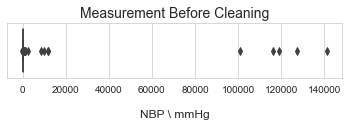

In [12]:
# Measurement Before Cleaning
plotdata = chartevents_before[chartevents_before.ITEMID == my_itemid_measurement]
fig, ax = plt.subplots(figsize = my_figsize_boxplot)
ax = sns.boxplot(
    data = plotdata, 
    x = my_xvalue_before,
    color = my_color_measurement
    )
ax.set_title("Measurement Before Cleaning", fontsize=my_title_fontsize)
ax.set_xlabel(my_xlabel, fontsize=12, labelpad=15)
# Save as file
# plt.savefig(str(path + 'boxplot_' + 'nbp_' + 'measurement_' + 'before-cleaning' + '.pdf'), bbox_inches='tight')
# Plot figure
plt.show(fig)

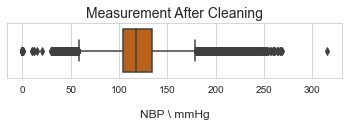

In [13]:
# Measurement After Cleaning
plotdata = chartevents_after[chartevents_after.ITEMID == my_itemid_measurement]
fig, ax = plt.subplots(figsize = my_figsize_boxplot)
ax = sns.boxplot(
    data = plotdata,
    x = my_xvalue_after,
    color = my_color_measurement
    )
ax.set_title("Measurement After Cleaning", fontsize=my_title_fontsize)
ax.set_xlabel(my_xlabel, fontsize=12, labelpad=15)
# Save as file
# plt.savefig(str(path + 'boxplot_' + 'nbp_' + 'measurement_' + 'after-cleaning' + '.pdf'), bbox_inches='tight')
# Plot figure
plt.show(fig)

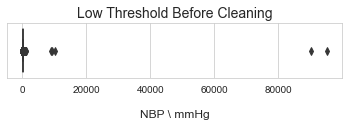

In [14]:
# Low Threshold Before Cleaning
plotdata = chartevents_before[chartevents_before.ITEMID == my_itemid_low_threshold]
fig, ax = plt.subplots(figsize = my_figsize_boxplot)
ax = sns.boxplot(
    data = plotdata, 
    x = my_xvalue_before,
    color = my_color_low_threshold
    )
ax.set_title("Low Threshold Before Cleaning", fontsize=my_title_fontsize)
ax.set_xlabel(my_xlabel, fontsize=12, labelpad=15)
# Save as file
# plt.savefig(str(path + 'boxplot_' + 'nbp_' + 'low-threshold_' + 'before-cleaning' + '.pdf'), bbox_inches='tight')
# Plot figure
plt.show(fig)

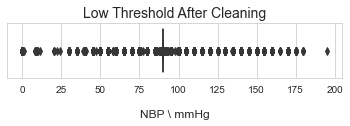

In [15]:
# Low Threshold After Cleaning
plotdata = chartevents_after[chartevents_after.ITEMID == my_itemid_low_threshold]
fig, ax = plt.subplots(figsize = my_figsize_boxplot)
ax = sns.boxplot(
    data = plotdata,
    x = my_xvalue_after,
    color = my_color_low_threshold
    )
ax.set_title("Low Threshold After Cleaning", fontsize=my_title_fontsize)
ax.set_xlabel(my_xlabel, fontsize=12, labelpad=15)
# Save as file
# plt.savefig(str(path + 'boxplot_' + 'nbp_' + 'low-threshold_' + 'after-cleaning' + '.pdf'), bbox_inches='tight')
# Plot figure
plt.show(fig)

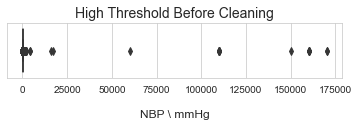

In [16]:
# High Threshold Before Cleaning
plotdata = chartevents_before[chartevents_before.ITEMID == my_itemid_high_threshold]
fig, ax = plt.subplots(figsize = my_figsize_boxplot)
ax = sns.boxplot(
    data = plotdata, 
    x = my_xvalue_before,
    color = my_color_low_threshold
    )
ax.set_title("High Threshold Before Cleaning", fontsize=my_title_fontsize)
ax.set_xlabel(my_xlabel, fontsize=12, labelpad=15)
# Save as file
# plt.savefig(str(path + 'boxplot_' + 'nbp_' + 'high-threshold_' + 'before-cleaning' + '.pdf'), bbox_inches='tight')
# Plot figure
plt.show(fig)

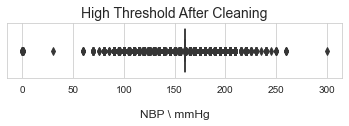

In [17]:
# High Threshold After Cleaning
plotdata = chartevents_after[chartevents_after.ITEMID == my_itemid_high_threshold]
fig, ax = plt.subplots(figsize = my_figsize_boxplot)
ax = sns.boxplot(
    data = plotdata,
    x = my_xvalue_after,
    color = my_color_low_threshold
    )
ax.set_title("High Threshold After Cleaning", fontsize=my_title_fontsize)
ax.set_xlabel(my_xlabel, fontsize=12, labelpad=15)
# Save as file
# plt.savefig(str(path + 'boxplot_' + 'nbp_' + 'high-threshold_' + 'after-cleaning' + '.pdf'), bbox_inches='tight')
# Plot figure
plt.show(fig)

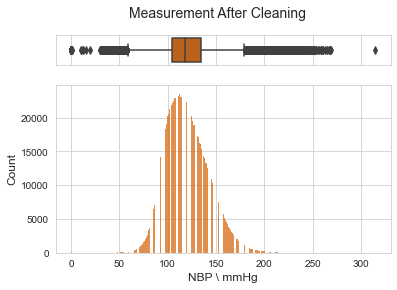

In [19]:
# Measurement After Cleaning
plotdata = chartevents_after[chartevents_after.ITEMID == my_itemid_measurement]
fig, (fig_box, fig_hist) = plt.subplots(
    2,
    sharex=True,
    gridspec_kw={"height_ratios": (.15, .85)},
    figsize=my_figsize_histogram)
fig.suptitle("Measurement After Cleaning", fontsize=my_title_fontsize)
sns.boxplot(ax=fig_box, data=plotdata, x=my_xvalue_after, color=my_color_measurement)
fig_box.set(xlabel="")
sns.histplot(ax=fig_hist, data=plotdata, x=my_xvalue_after, kde=False, color=my_color_measurement)
fig_hist.set_xlabel(my_xlabel, fontsize=my_xlabel_fontsize)
fig_hist.set_ylabel("Count", fontsize=my_ylabel_fontsize)
# Save as file
# plt.savefig(str(path + 'histrogram_' + 'nbp_' + 'measurement_' + 'after-cleaning' + '.pdf'), bbox_inches='tight')
# Show plot
plt.show(fig)

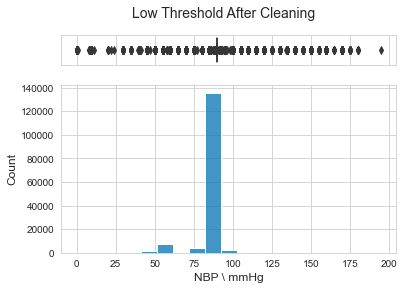

In [20]:
# Low Threshold After Cleaning
plotdata = chartevents_after[chartevents_after.ITEMID == my_itemid_low_threshold]
fig, (fig_box, fig_hist) = plt.subplots(
    2,
    sharex=True,
    gridspec_kw={"height_ratios": (.15, .85)},
    figsize=my_figsize_histogram)
fig.suptitle("Low Threshold After Cleaning", fontsize=my_title_fontsize)
sns.boxplot(ax=fig_box, data=plotdata, x=my_xvalue_after, color=my_color_low_threshold)
fig_box.set(xlabel="")
sns.histplot(ax=fig_hist, data=plotdata, x=my_xvalue_after, kde=False, color=my_color_low_threshold)
fig_hist.set_xlabel(my_xlabel, fontsize=my_xlabel_fontsize)
fig_hist.set_ylabel("Count", fontsize=my_ylabel_fontsize)
# Save as file
# plt.savefig(str(path + 'histrogram_' + 'nbp_' + 'low-threshold_' + 'after-cleaning' + '.pdf'), bbox_inches='tight')
# Show plot
plt.show()

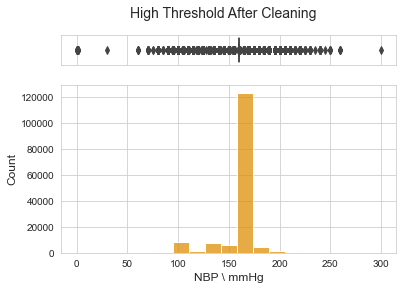

In [21]:
# High Threshold After Cleaning
plotdata = chartevents_after[chartevents_after.ITEMID == my_itemid_high_threshold]
fig, (fig_box, fig_hist) = plt.subplots(
    2,
    sharex=True,
    gridspec_kw={"height_ratios": (.15, .85)},
    figsize=my_figsize_histogram)
fig.suptitle("High Threshold After Cleaning", fontsize=my_title_fontsize)
sns.boxplot(ax=fig_box, data=plotdata, x=my_xvalue_after, color=my_color_high_threshold)
fig_box.set(xlabel="")
sns.histplot(ax=fig_hist, data=plotdata, x=my_xvalue_after, kde=False, color=my_color_high_threshold)
fig_hist.set_xlabel(my_xlabel, fontsize=my_xlabel_fontsize)
fig_hist.set_ylabel("Count", fontsize=my_ylabel_fontsize)
# Save as file
# plt.savefig(str(path + 'histrogram_' + 'nbp_' + 'high-threshold_' + 'after-cleaning' + '.pdf'), bbox_inches='tight')
# Show plot
plt.show()